In [41]:
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt

import igraph as ig
import math
import numpy as np

import datetime
import dateutil.parser
import pytz

In [42]:
df = pd.read_csv("./datasets/data.csv")

<Axes: xlabel='id_questao'>

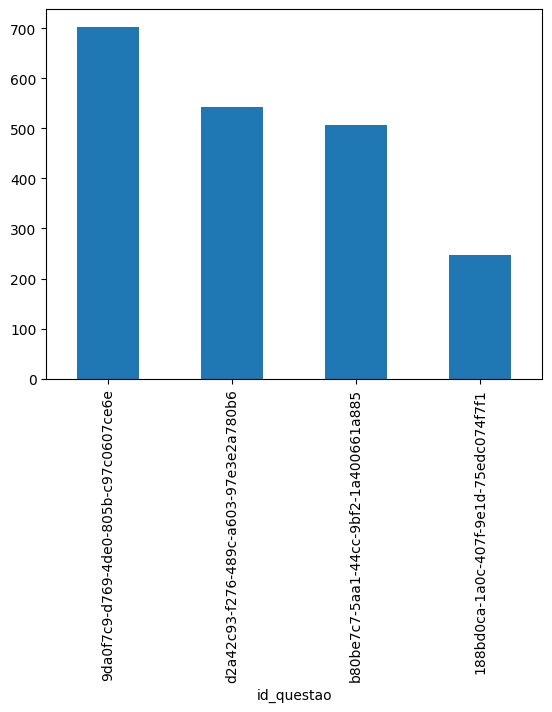

In [43]:
df["id_questao"].value_counts().plot(kind="bar")

In [44]:
grouped = df.groupby('id_aluno').agg({
    'id_questao':list, 'acerto_resposta':list, 'tempo_resposta': list}).reset_index()
grouped.head(7)

,id_aluno,id_questao,acerto_resposta,tempo_resposta
0,0001a842-b701-4322-9986-4cdd8b1315ff,[d2a42c93-f276-489c-a603-97e3e2a780b6],[1.0],[21.0]
1,004dbe3a-9593-4132-8531-370c5330ac14,"[b80be7c7-5aa1-44cc-9bf2-1a400661a885, b80be7c...","[0.0, 0.0, 0.0, 0.0]","[12.0, 45.0, 9.0, 84.0]"
2,00597ae8-3d52-498a-accb-640d6d3e6c6e,[d2a42c93-f276-489c-a603-97e3e2a780b6],[1.0],[4.0]
3,006bd505-1e0d-4fa8-ba7b-82d7d33067e6,[d2a42c93-f276-489c-a603-97e3e2a780b6],[1.0],[140.0]
4,0087d4d8-9a1d-4834-9b9c-2e1417133a67,[d2a42c93-f276-489c-a603-97e3e2a780b6],[1.0],[266.0]
5,00f836bc-4a97-4944-a5aa-c4d58e17188a,"[9da0f7c9-d769-4de0-805b-c97c0607ce6e, 9da0f7c...","[0.0, 0.0, 1.0, 1.0, 0.0, 1.0, 0.0, 0.0]","[3.0, 10.0, 12.0, 16.0, 27.0, 19.0, 25.0, 4.0]"
6,00fdd6e2-08a6-499b-a5cf-983c0482905d,[d2a42c93-f276-489c-a603-97e3e2a780b6],[0.0],[329.0]


In [45]:
# grouped["countUniqueQuestions"] = grouped.index
# for a in grouped.index:
#     grouped["countUniqueQuestions"][a] = len(np.unique(grouped["id_questao"][a]))
# pd.DataFrame(grouped["countUniqueQuestions"].value_counts()).plot(kind='bar', rot=0, xlabel='Número de questões únicas respondidas')

In [46]:
# grouped["countQuestions"] = grouped.index
# for a in grouped.index:
#     grouped["countQuestions"][a]= 10
#     grouped["countQuestions"][a] = len(grouped["id_questao"][a])
# pd.DataFrame(grouped["countQuestions"].value_counts()).plot(kind='bar', rot=0, xlabel='Número de questões respondidas pelo aluno',
#                                                             ylabel='Quantidade de Alunos')

In [47]:
# Alguns casos de mesmo aluno respondendo a mesma questão - utilizando como dado e não como sujeira
grouped.iloc[5]["id_questao"]

['9da0f7c9-d769-4de0-805b-c97c0607ce6e',
 '9da0f7c9-d769-4de0-805b-c97c0607ce6e',
 'd2a42c93-f276-489c-a603-97e3e2a780b6',
 'd2a42c93-f276-489c-a603-97e3e2a780b6',
 'b80be7c7-5aa1-44cc-9bf2-1a400661a885',
 'b80be7c7-5aa1-44cc-9bf2-1a400661a885',
 '188bd0ca-1a0c-407f-9e1d-75edc074f7f1',
 '188bd0ca-1a0c-407f-9e1d-75edc074f7f1']

In [53]:
def compare_integers_power_law(integer1, integer2, max_value):
    log_absolute_difference = abs(math.log(integer1 + 1) - math.log(integer2 + 1))
    log_max_value = math.log(max_value + 1)
    metric = 1 - log_absolute_difference / log_max_value
    return max(0, metric)  # Garante que a métrica retorna entre 0 e 1

In [54]:
compare_integers_power_law(1001,1002,10000000)

0.9999381126447852

[0,max] 
1 - log(|a - b|)/log(max) pois a distribuição de tempo parece seguir uma lei de potência (power law).

Logo a distribuição de valores de tempo entre [0,max] não é uniforme, um tempo de resposta 1.0 segundos e um tempo 3.0 s devem ser metrificados como menos similares (mais distantes/distintos) que um tempo de 201.0 segundos e um de 205.0 segundos. Os últimos tem probabilidade de ocorrência mais similares que os primeiros.

In [55]:
grouped = df.groupby('id_aluno').agg({
    'id_questao':list, 'acerto_resposta':list, 'tempo_resposta': list}).reset_index()
edges = []
weights = []
maxTime = df['tempo_resposta'].max()
numStudents = df["id_aluno"].nunique()
# Para cada par único de alunos
for a0 in grouped.index:
    for a1 in grouped[a0+1:].index:
        peso = 0
        # Para cada par entre as respostas entre um e outro.
        for t0 in range(0,len(grouped["id_questao"][a0])):
            for t1 in range(0,len(grouped["id_questao"][a1])):
                # Se mesma questão:
                    #   Soma ao peso da aresta entre alunos dependendo da similaridade da questão
                if (grouped["id_questao"][a0][t0] == grouped["id_questao"][a1][t1]):
                    diffTempo = compare_integers_power_law(
                        grouped["tempo_resposta"][a0][t0],
                        grouped["tempo_resposta"][a1][t1],
                        maxTime
                    )
                    diffAcerto = grouped["acerto_resposta"][a0][t0] == grouped["acerto_resposta"][a1][t1]
                    peso += diffTempo*diffAcerto
        if (peso > 0):
            edges.append((a0,a1))
            weights.append(peso)


In [56]:
pd.DataFrame(weights).describe()

,0
count,164219.000000
mean,1.339223
std,1.346781
min,0.133151
25%,0.753258
50%,0.921887
75%,1.596559
max,41.591316


In [57]:
len(edges) # = (numStudents * (numStudents - 1))/2

164219

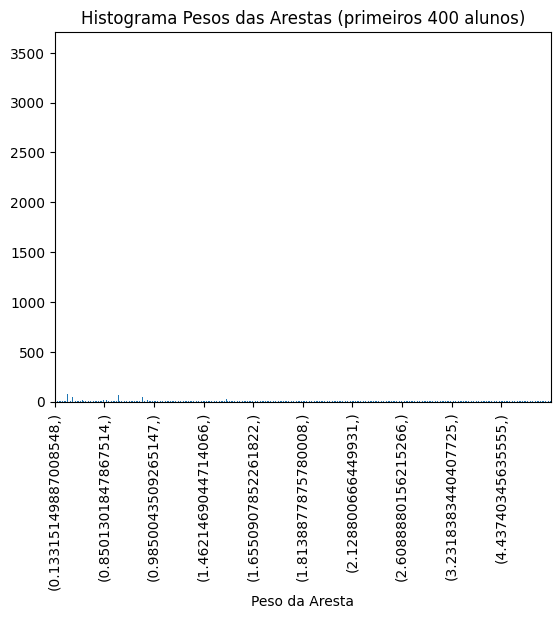

In [88]:
pd.DataFrame(weights).value_counts().sort_index().plot(kind='bar', title="Histograma Pesos das Arestas (primeiros 400 alunos)", xlabel='Peso da Aresta').locator_params(axis='x', nbins=10)
# pd.DataFrame(weights).value_counts().plot(kind='line', ylabel="Histograma Pesos (loglog)",loglog=True, xticks=[])

<Axes: title={'center': 'Histograma Pesos (loglog)'}, xlabel='Pesos ordenados por ocorrência'>

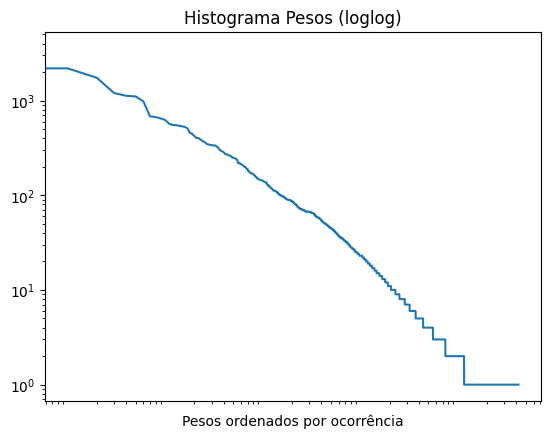

In [59]:
pd.DataFrame(weights).value_counts().plot(kind='line', title="Histograma Pesos (loglog)",loglog=True, xlabel='Pesos ordenados por ocorrência', xticks=[])

<Axes: title={'center': 'Histograma dos Pesos (loglog)'}, xlabel='Peso', ylabel='Ocorrência'>

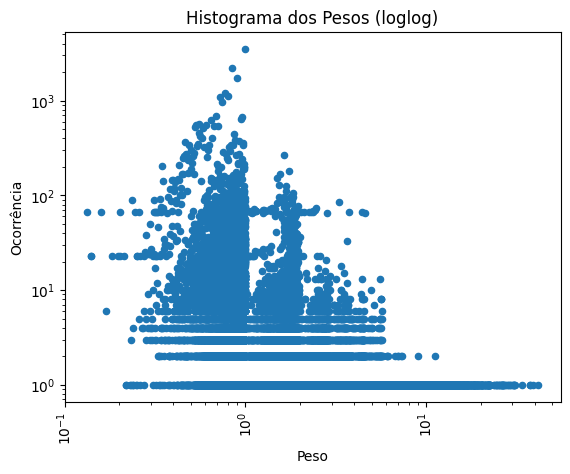

In [60]:
df3 = pd.DataFrame(pd.DataFrame(weights).value_counts()).reset_index()
df3.plot(kind='scatter',x=0,y="count",
         title="Histograma dos Pesos (loglog)",
         ylabel="Ocorrência", xlabel="Peso", loglog=True, rot=90)

In [61]:
def createGraph(n_vertices, edges, weights):
    g = ig.Graph(n_vertices, edges)
    g["title"] = "Similaridade entre Alunos"
    g.es["weights"] = weights
    return g

g = createGraph(numStudents, edges, weights)

In [62]:
weightedDegrees = []
for a in g.vs:
    sum = 0
    for ea in a.incident():
        sum += ea.attributes()["weights"]
    weightedDegrees.append(sum)
pd.DataFrame(weightedDegrees).describe()
# pd.DataFrame(weightedDegrees).value_counts().tail(-2).head(70).plot(kind='bar', ylabel="Histograma Graus com Pesos", xticks=[])
# Removendo os dois alunos com grau outlier (múltiplas respostas)
# pd.DataFrame(weightedDegrees).value_counts().head(70).plot(kind='bar', ylabel="Histograma Graus com Pesos", xticks=[])


,0
count,882.000000
mean,498.698055
std,438.319884
min,76.134622
25%,237.374625
50%,310.793731
75%,667.742510
max,3287.218059


In [63]:
w_df2 = pd.DataFrame(weightedDegrees)
w_df2[w_df2[0] > 2970]
grouped[grouped.index == 412]["tempo_resposta"]

412    [1.0, 0.0, 0.0, 1.0, 4.0, 2.0, 5.0, 1.0, 0.0, ...
Name: tempo_resposta, dtype: object

In [64]:
grouped.iloc[195]

id_aluno                        3a280b06-eff7-4016-988f-4fbb6e54d22e
id_questao         [d2a42c93-f276-489c-a603-97e3e2a780b6, b80be7c...
acerto_resposta                                      [1.0, 1.0, 1.0]
tempo_resposta                                    [74.0, 45.0, 23.0]
Name: 195, dtype: object

<Axes: >

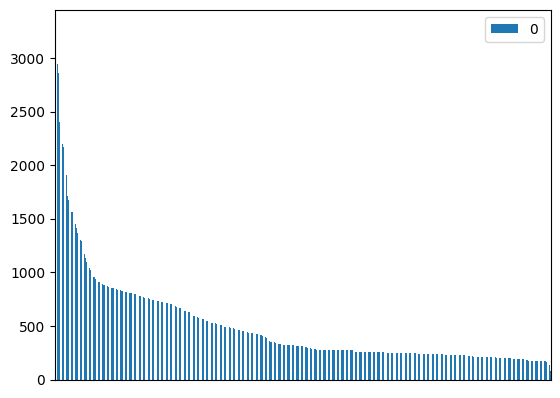

In [65]:
w_df2.sort_values(by=0, ascending=False).plot(kind="bar", xticks=[])

In [66]:
w_df2.sort_values(by=0, ascending=False).head(10)

,0
412,3287.218059
600,3269.923429
299,3000.260010
251,2984.621772
700,2949.325370
90,2864.369208
240,2861.183049
524,2559.923420
874,2404.013445
633,2377.545574


In [67]:
def plotGraph(g, name):
    # Note that attributes can be set globally (e.g. vertex_size), or set individually using arrays (e.g. vertex_color)
    fig, ax = plt.subplots(figsize=(5,5))
    ig.plot(
        g,
        target=ax,
        vertex_size=0.1,
        vertex_color=["steelblue"],
        vertex_frame_width=4.0,
        vertex_frame_color="white",
        vertex_label=g.vs.indices,
        vertex_label_size=7.0
        # edge_color=g.es["weights"]
        # edge_color=["#7142cf" if win == "1" else "salmon" for win in g.es["weights"]]
    )
    plt.show()
    fig.savefig(name + '.png')
    fig.savefig(name + '.jpg')
    fig.savefig(name + '.pdf')
    g.save(name + ".gml")
    g = ig.load(name + ".gml")
# plotGraph(g, "Alunos_2")

clusterizar
- modularidade
- NMI

<Axes: xlabel='tempo_resposta', ylabel='Frequência de ocorrência'>

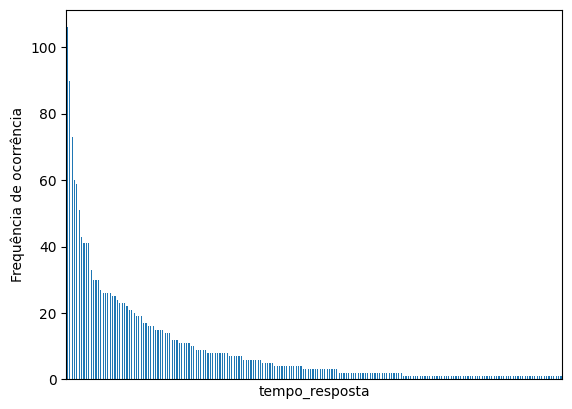

In [68]:
# df["tempo_resposta"].value_counts().head(50).plot(kind='bar', ylabel="Frequência de ocorrência")
# .tail(-1) pois df["tempo_resposta"] == 0.0 é muito frequente
df["tempo_resposta"].value_counts().tail(-1).head(300).plot(kind='bar', ylabel="Frequência de ocorrência", xticks=[])
# df["tempo_resposta"].value_counts().tail(-1).plot(kind='bar', ylabel="Frequência de ocorrência")

In [69]:
clusteredIM = g.community_infomap(edge_weights='weights', trials=15)
print("Modularidade: " + str(clusteredIM.modularity))
clusteredIM.summary()

Modularidade: 0.0


'Clustering with 882 elements and 1 clusters'

In [70]:
clusteredFG = g.community_fastgreedy(weights='weights').as_clustering()
print("Modularidade: " + str(clusteredFG.modularity))
clusteredFG.summary()

Modularidade: 0.2408638281375374


'Clustering with 882 elements and 4 clusters'

In [71]:
clusteredLP = g.community_label_propagation(weights='weights',initial=[+(i < 100) for i in range(0,numStudents)])
print("Modularidade: " + str(clusteredLP.modularity))
clusteredLP.summary()

Modularidade: 0.0


'Clustering with 882 elements and 1 clusters'

In [72]:
clusteredLE = g.community_leading_eigenvector(weights='weights')
print("Modularidade: " + str(clusteredLE.modularity))
clusteredLE.summary()

Modularidade: 0.25786155650192405


'Clustering with 882 elements and 4 clusters'

In [73]:
clusteredL = g.community_leiden(weights='weights',resolution_parameter=0.17, beta=1, n_iterations=10)
print("Modularidade: " + str(clusteredL.modularity))
clusteredL.summary()       

Modularidade: 0.7914417430792152


/tmp/ipykernel_20569/1996311836.py:1: DeprecationWarning: resolution_parameter keyword argument is deprecated, use resolution=... instead
  clusteredL = g.community_leiden(weights='weights',resolution_parameter=0.17, beta=1, n_iterations=10)


'Clustering with 882 elements and 3 clusters'

In [74]:
clusteredML = g.community_multilevel(weights='weights')
print("Modularidade: " + str(clusteredML.modularity))
clusteredML.summary()

Modularidade: 0.274417076633231


'Clustering with 882 elements and 4 clusters'

In [75]:
# DANGER | DANGER | DANGER | Chrashando o notebook
# clusteredOM = g.community_optimal_modularity(weights='weights')
# print("Modularidade: " + str(clusteredOM.modularity))
# clusteredOM.summary()       

In [76]:
# 2m 50s + runtime
# clusteredSG = g.community_spinglass(weights='weights')
# print("Modularidade: " + str(clusteredSG.modularity))
# clusteredSG.summary()

In [77]:
clusteredWT = g.community_walktrap(weights='weights').as_clustering()
print("Modularidade: " + str(clusteredWT.modularity))
clusteredWT.summary()

Modularidade: 0.18703751580057593


'Clustering with 882 elements and 3 clusters'

/tmp/ipykernel_20569/28832953.py:1: DeprecationWarning: resolution_parameter keyword argument is deprecated, use resolution=... instead
  a = [ g.community_leiden(weights='weights',resolution_parameter=i*0.05, beta=1, n_iterations=10).modularity for i in range(0,20)]


<Axes: xlabel='Resolution Parameter', ylabel='Modularidade'>

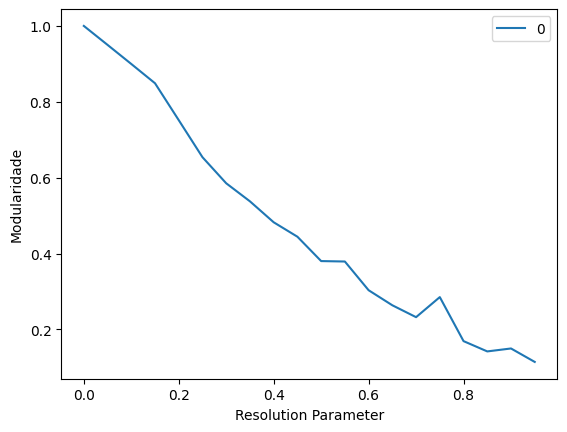

In [78]:
a = [ g.community_leiden(weights='weights',resolution_parameter=i*0.05, beta=1, n_iterations=10).modularity for i in range(0,20)]
dfL = pd.DataFrame(a, [i*0.05 for i in range(0,20)])
dfL.plot(kind='line', xlabel='Resolution Parameter', ylabel="Modularidade")
# a["y"] = [i for i in range(0,20)]
# a

In [79]:
def plotGraphWithClusterColors(g, clustering, name):
    # Note that attributes can be set globally (e.g. vertex_size), or set individually using arrays (e.g. vertex_color)
    fig, ax = plt.subplots(figsize=(5,5))
    clusterToColor = { 0: "steelblue", 1: "salmon", 2: "yellow", 3: "#333333",
                       4: "#000000", 5: "#606060", 6: "#909090", 7: "#C0C0C0",}
    ig.plot(
        g,
        target=ax,
        vertex_size=0.1,
        vertex_color=[clusterToColor[a] for a in clustering.membership],
        # vertex_frame_width=4.0,
        # vertex_frame_color="white",
        vertex_label=g.vs.indices,
        vertex_label_size=4.0
        # edge_color=g.es["weights"]
        # edge_color=["#7142cf" if win == "1" else "salmon" for win in g.es["weights"]]
    )
    plt.show()
    fig.savefig(name + '.png')
    fig.savefig(name + '.jpg')
    fig.savefig(name + '.pdf')
    g.save(name + ".gml")
    g = ig.load(name + ".gml")
# plotGraph(g, "Alunos_2")

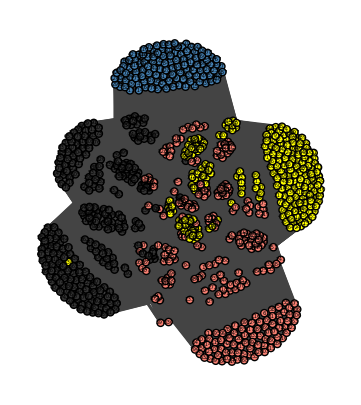

In [80]:
plotGraphWithClusterColors(g, clusteredFG, "Clusteres Fast and Greedy")
# |C| = 4, M = 0,24

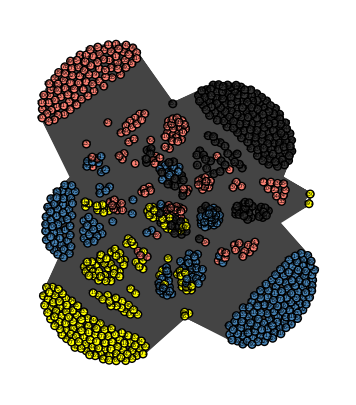

In [81]:
plotGraphWithClusterColors(g, clusteredLE, "Clusteres Leading Eigenvector")
# |C| = 4, M = 0.26

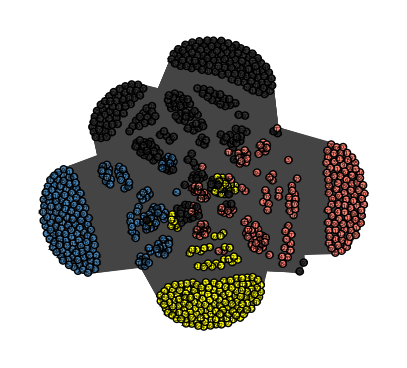

In [82]:
plotGraphWithClusterColors(g, clusteredML, "Clustered Multilevel")
# |C| = 5, M = 0.27

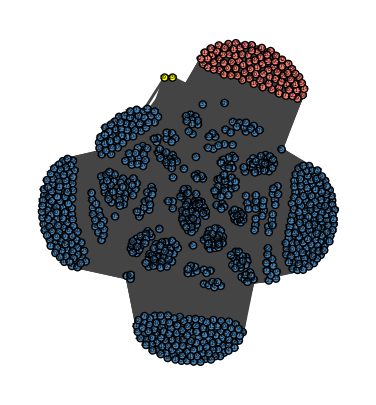

In [83]:
plotGraphWithClusterColors(g, clusteredL, "Clustered Leiden R=0.17")
# |C| = 8, M = 0.74

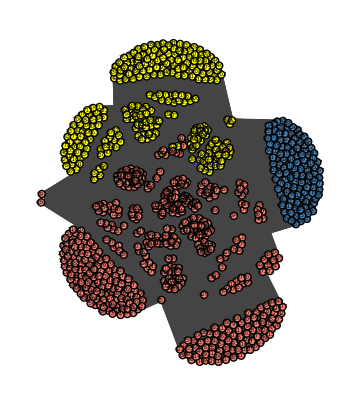

In [84]:
plotGraphWithClusterColors(g, clusteredWT, "Clustered WalkTrap")
# |C| = 5, M = 0.18

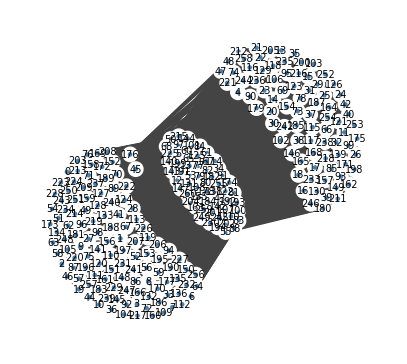

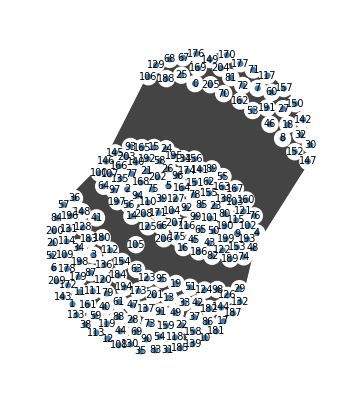

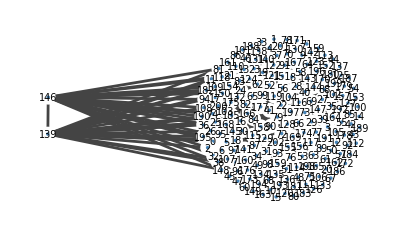

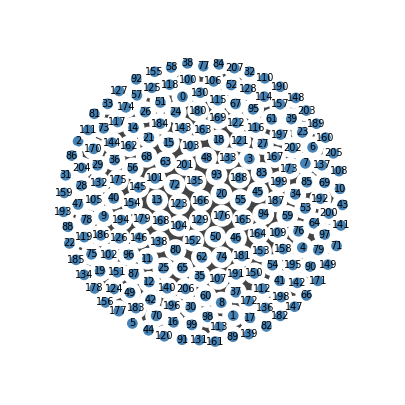

In [85]:
for subgraph in clusteredLE.subgraphs():
    plotGraph(subgraph,"yo")

In [86]:
ig.plot(g,mark_groups={})

In [87]:
i=0
for subg in clusteredL.subgraphs():
    i+=1
    print("Subgrafo "+str(i)+": N = " + str(len(subg.vs)))

Subgrafo 1: N = 795
Subgrafo 2: N = 85
Subgrafo 3: N = 2
